# Prep from Question 1 (from hw5)

In [11]:
dataFullLink = 'http://www.cdslab.org/recipes/programming/regression-gaussian-data/dataFull.csv'

In [12]:
import pandas as pd

In [13]:
import matplotlib.pyplot as plt

In [14]:
import numpy as np

In [15]:
data = pd.read_csv(dataFullLink)

In [16]:
datalog = data.copy()
datalog['variable'] = [math.log(i) for i in datalog['variable']]

In [17]:
import scipy.optimize as optimize

# Question 2

In [18]:
data0 = pd.read_csv('http://www.cdslab.org/recipes/programming/regression-censored-gaussian-data/data.csv', header=None)

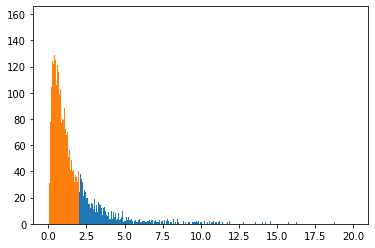

In [19]:
plt.figure()
plt.hist(data, bins = [i/100 for i in range(0, 2000)])
plt.hist(data0, bins = [i/100 for i in range(0, 2000)])
plt.show()

In [20]:
datalog0 = data0.copy()
datalog0[0] = [math.log(i) for i in datalog0[0]]

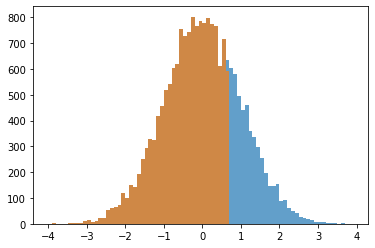

In [21]:
plt.figure()
plt.hist(datalog, bins = [i/10 for i in range(-40, 40)], alpha = .7)
plt.hist(datalog0, bins = [i/10 for i in range(-40, 40)], alpha = .7)
plt.show()

In [22]:
datalog0

,0
0,-1.587921
1,-0.033174
2,-0.467575
3,-0.511259
4,-0.180348
...,...
15022,-0.950365
15023,0.383969
15024,0.386214
15025,-1.558887


# Caramonte

(array([3.000e+00, 1.800e+01, 6.800e+01, 2.660e+02, 6.490e+02, 1.382e+03,
        2.388e+03, 3.365e+03, 3.627e+03, 3.261e+03]),
 array([-3.96100319, -3.49560315, -3.03020312, -2.56480308, -2.09940304,
        -1.63400301, -1.16860297, -0.70320294, -0.2378029 ,  0.22759713,
         0.69299717]),
 <BarContainer object of 10 artists>)

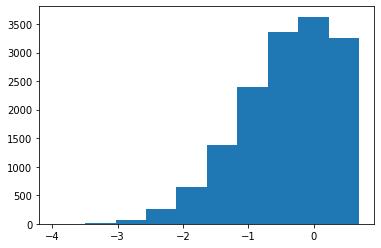

In [26]:
x = datalog0[0]
NDATA = len(x)

fig = plt.figure()
ax = plt.subplot()
ax.hist(x)

In [25]:
def getNormLogPDF(x, mean, std, logStd):
    return -0.5 * np.log(2*np.pi) - logStd - (x - mean)**2 / (2*std**2)

In [33]:
SQRT_TWO = np.sqrt(2)
from scipy.special import erf
def getTrunchNormCDF(x, mean, std):
    return .5 + .5 * erf((x-mean)/(std*SQRT_TWO))

In [34]:
getTrunchNormCDF(0.7, 0, 1)

0.758036347776927

In [35]:
from scipy.stats import norm
norm.cdf(0.7, 0, 1)

0.758036347776927

In [36]:
def getLogLike(params):
    mean, logStd, cut = params
    std = np.exp(logStd)
    normFac = getTrunchNormCDF(cut, mean, std)
    if np.any(x > cut) :
        return -1.e200
    else:
        return sum(getNormLogPDF(x, mean, std, logStd) - normFac)

In [ ]:
class Normal():

    def __init__(self, normallyDistributedData):
        self.data = normallyDistributedData
        self.ndata = len(self.data)
        self.maxdata = np.max(self.data)

    def getLogProb(self, data, avg, logStd, cutoff):
        """
        Return the logarithm of the probability density of an input set of x values, 
        given the input parameters (avg,logStd,cutoff) for the Gaussian PDF.
        """
        std = np.exp(logStd)
        return -0.9189385332 - logStd - 0.5 * ( (data-avg) / std )**2 - np.log(sp.stats.norm.cdf(cutoff, avg, std))

    def getLogLike(self,param):
        if param[2] < self.maxdata:
            # data cannot be larger than the threshold, 
            # therefore such input parameter set for the censored Normal distribution is impossible.
            # In such occasion, we return negative infinity as the logLikelihood value.
            return -1.e300
        else:
            return np.sum( self.getLogProb(self.data, param[0], param[1], param[2]) )

In [29]:
getLogLike([0, 1, .7])

-47638.25901290834

In [30]:
getLogLike([0, 1, 1])

-48897.78664310707

In [31]:
getLogLike([0, 1, .5])

-1e+200

In [32]:
getLogLike([0, .9, .7])

-46608.32247405553

In [33]:
getLogLike([0, 1.1, .7])

-48725.047981313444

In [34]:
getLogLike([0.1, 1, .7])

-47304.680972146154

In [35]:
getLogLike([-0.1, 1, .7])

-47988.13293837428

In [37]:
import paramonte as pm

In [38]:
pm.version.interface.dump() # get the version of ParaMonte we are working with
pmpd = pm.ParaDRAM() # create a ParaDRAM sampler object
pmpd.spec.chainSize = 20000 # change the number of sampled points from default 100,000 to 30,000
pmpd.spec.overwriteRequested = True
pmpd.spec.outputFileName = "./output" # change the number of sampled points from default 100,000 to 30,000
pmpd.spec.variableNameList = ["Average","LogStandardDeviation","Cut"]
pmpd.spec.startPointVec = [0,0,0.7] # ensure the initial starting point of the search for cutoff is good.
pmpd.spec.targetAcceptanceRate = [0.1,0.3] # ensure the MCMC sampling efficiency does not become too large or too small.

In [39]:
pmpd.runSampler( ndim = 3
               , getLogFunc = getLogLike
               )


ParaDRAM - NOTE: Running the ParaDRAM sampler in serial mode...
ParaDRAM - NOTE: To run the ParaDRAM sampler in parallel mode visit:
ParaDRAM - NOTE: 
ParaDRAM - NOTE:     https://www.cdslab.org/paramonte
ParaDRAM - NOTE: 
ParaDRAM - NOTE: If you are using Jupyter notebook, check the Jupyter's 
ParaDRAM - NOTE: terminal window for realtime simulation progress and report.



NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

C:\Users\shahmoradia\Anaconda3\lib\site-packages\ipykernel_launcher.py:3: RuntimeWarning: overflow encountered in exp
  This is separate from the ipykernel package so we can avoid doing imports until


NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

C:\Users\shahmoradia\Anaconda3\lib\site-packages\ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in double_scalars
  after removing the cwd from sys.path.


NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined

NameError: name 'getNormLogPDF' is not defined


ParaDRAM - FATAL: The simulation failed. For more information, checkout the 
ParaDRAM - FATAL: simulation output error message on your your Bash / Python 
ParaDRAM - FATAL: terminal or command-prompt, also at the end of the output report 
ParaDRAM - FATAL: file, if it has been generated:
ParaDRAM - FATAL: 
ParaDRAM - FATAL:     D:\Dropbox\Projects\20190704_recipes\recipes.raw\programming\regression-erf-censored-gaussian-data\output_report.txt
ParaDRAM - FATAL: 
ParaDRAM - FATAL: It appears that an old ParaDRAM simulation with 
ParaDRAM - FATAL: the same output file names exists in the specified path:
ParaDRAM - FATAL: 
ParaDRAM - FATAL: D:\Dropbox\Projects\20190704_recipes\recipes.raw\programming\regression-erf-censored-gaussian-data\output_process_1_chain.txt
ParaDRAM - FATAL: D:\Dropbox\Projects\20190704_recipes\recipes.raw\programming\regression-erf-censored-gaussian-data\output_process_1_progress.txt
ParaDRAM - FATAL: D:\Dropbox\Projects\20190704_recipes\recipes.raw\programming\re

Exception: Fatal error occurred. Gracefully exiting.

In [ ]:
sample = pmpd.readSample(renabled = True)[0]
sample.df.mean()

In [ ]:
sample = pmpd.readSample(renabled = True)[0]

# plot traceplots of the sampled parameters

for colname in sample.df.columns:
    sample.plot.line.ycolumns = colname
    sample.plot.line.outputFile = "traceplot_" + colname
    sample.plot.line()
    sample.plot.line.currentFig.axes.set_xlabel("MCMC Count")
    sample.plot.line.currentFig.axes.set_ylabel(colname)

# plot the histograms of the sampled parameters

for colname in sample.df.columns:
    sample.plot.histplot.columns = colname
    sample.plot.histplot.outputFile = "histogram_" + colname
    sample.plot.histplot()
    sample.plot.histplot.currentFig.axes.set_xlabel(colname)
    sample.plot.histplot.currentFig.axes.set_ylabel("MCMC Count")

# Question 3

In [ ]:
q3link = 'https://www.cdslab.org/recipes/programming/regression-censored-mvn-data/data.csv'

In [ ]:
q3 = pd.read_csv(q3link)
q3 = q3[['variable1', 'variable2']]

In [ ]:
q3

In [ ]:
plt.figure()
plt.scatter(q3['variable1'], q3['variable2'])
plt.show()

In [ ]:
d3 = q3.copy()
d3['variable1'] = [math.log(i) for i in d3['variable1']]
d3['variable2'] = [math.log(i) for i in d3['variable2']]
d3

In [ ]:
plt.figure()
plt.scatter(d3['variable1'], d3['variable2'])
plt.show()

In [ ]:
plt.figure()
plt.hist(d3['variable1'], bins = [i/10 for i in range(-40, 40)], alpha = .7)
plt.hist(d3['variable2'], bins = [i/10 for i in range(-40, 40)], alpha = .7)
plt.show()